### Read in Data

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import pandas as pd
import geopandas as gpd
import seaborn as sns
import researchpy as rp
import folium
from random import sample 
from folium.plugins import HeatMap
from descartes.patch import PolygonPatch
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.collections import PolyCollection
from matplotlib.collections import PatchCollection

#Need to go through these imports to see what ones I actually end up using

In [11]:
listings_detail = pd.read_excel('../CourseProject/data/listings_detail.xlsx', index_col=0)
calendar_detail = pd.read_excel('../CourseProject/data/calendar_detail.xlsx' , index_col=0)
neighbourhoods = pd.read_excel('../CourseProject/data/neighbourhoods.xlsx', index_col=0)
reviews = pd.read_excel('../CourseProject/data/reviews_detail.xlsx', index_col=0)
crime = pd.read_excel('../CourseProject/data/NYPD_Arrests_Data__Historic_.xlsx', index_col=0)
nbgeo = gpd.read_file('../CourseProject/data/neighbourhoods.geojson')
ls=pd.read_csv('../CourseProject/data/listings_summary.csv', index_col=0)

### Data Cleaning
There are many missing values which either need to be removed or estimated so that they do not affect our results

In [3]:
#How many records we start with
print(f'Number of records: {listings_detail.count()[0]}')

Number of records: 44317


In [4]:
#What is missing in listing summary?
ls.isna().sum()

name                                28
host_id                              0
host_name                          232
neighbourhood_group                  0
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       9440
reviews_per_month                 9474
calculated_host_listings_count       0
availability_365                     0
dtype: int64

No values that are essential to our analysis are missing in listing summary

In [5]:
#What is missing in listing details?
listings_detail.isna().sum()

listing_url                             0
scrape_id                               0
last_scraped                            0
name                                   39
summary                              1523
space                               14514
description                            29
experiences_offered                     0
neighborhood_overview               18720
notes                               28229
transit                             16986
access                              19127
interaction                         19965
house_rules                         19208
thumbnail_url                        3305
medium_url                           3305
picture_url                             0
xl_picture_url                       3305
host_id                                 0
host_url                                0
host_name                             232
host_since                            232
host_location                         406
host_about                        

There are many missing values in the listing details dataset which we need to either estimate or eliminate. We estimate the missing reviews per month by using the median values. Then we also want to remove records that do not have a room and that are "free" or below \\$30, since many that I went through were not really listed as the price in the dataset. Similarly for rooms with a price of \\$2000 or higher (there were only 44), so we manually went through each URL and removed ones that were incorrectly listed in the dataset. There were only a few (10) that are actually listed at that price, and these are penthouses or luxury apartments used for shooting film or photography. It makes sense that there are not many of these, since people who can afford these properties most likely would not bother to rent it out for Airbnb. There are too many to manually go through that are listed with very low prices (less than \\$50) so we removed these. I looked through several of these and found that many were no longer listed.

In [43]:
#Fix NaN in review per month ???will we use this
ls["reviews_per_month"].fillna(0,inplace=True)

#Estimate attempt:
#Use to fill in missing values with median
def impute_median(series):
    return series.fillna(series.median())

listings_detail.loc['reviews_per_month']=listings_detail["reviews_per_month"].transform(impute_median)


#Remove records that do not have a room to offer
listings_detail=listings_detail[listings_detail['room_type'] != 0]

#Remove records that are "free" or too low
listings_detail=listings_detail[listings_detail['price']>50]
ls=ls[ls['price']>50]

listings_detail=listings_detail.drop([20316497,7003697,20649348,16429718,4737930,9528920,12955683,2271504,12520066,16810657,14590978,1448703,18051877,2236419,12376888, 16122505,14800877,20211893,2939700,2281142,18722535,11039478,18889094, 2274084, 19698169, 18109509,18190744,363673, 18323408,13915528,16594414,17975659,15307748])
ls=ls.drop([20316497,7003697,20649348,16429718,4737930,9528920,12955683,2271504,12520066,16810657,14590978,1448703,18051877,2236419,12376888, 16122505,14800877,20211893,2939700,2281142,18722535,11039478,18889094, 2274084, 19698169, 18109509,18190744,363673, 18323408,13915528,16594414,17975659,15307748])

KeyError: '[20316497 7003697 20649348 16429718 4737930 9528920 12955683 2271504\n 12520066 16810657 14590978 1448703 18051877 2236419 12376888 16122505\n 14800877 20211893 2939700 2281142 18722535 11039478 18889094 2274084\n 19698169 18109509 18190744 363673 18323408 13915528 16594414 17975659\n 15307748] not found in axis'

In [45]:
#How many records we have now
print(f'Number of records after cleaning: {listings_detail.count()[0]}')

Number of records after cleaning: 38782


Instead of defining areas by using a center longitude and latitude with a certain radius, we are going to use the pre-defined neighborhoods. Since there are so many (202), we are not going to look at all of them, but will point out ones that are significant (for example, the ones that have the highest ant lowest prices), and will do research to justify our results.

### Merging

In [27]:
#Merge Calendar Details with Listing Summary 
cdmergels=pd.merge(calendar_detail, ls, left_on='listing_id', right_index=True, how='left')
#Merge all three so we have have the boroughs (neighbourhood_group)
cdmergeldls=pd.merge(cdmergels, listings_detail, left_on='listing_id', right_index=True, how='left')
#Merge Listing Details and Listing Summary
ldmergels=pd.merge(listings_detail,ls,left_index=True, right_index=True, how='left')

### EDA 

In [18]:
#there's 202 unique neighborhoods - do we want to reduce this? how?
listings_detail['neighbourhood'].nunique()

202

In [19]:
print(cdmergels.date.min())
print(cdmergels.date.max())

2017-10-02 00:00:00
2018-10-02 00:00:00


Our Airbnb data is from October 2, 2017 to October 2, 2018

In [20]:
print(crime.ARREST_DATE.min())
print(crime.ARREST_DATE.max())

2014-09-06 00:00:00
2017-12-31 00:00:00


Our crime data is from Septemper 6, 2014 to December 31, 2017

<b> Issue: is this ok that our dates are not over the same range? Not sure if we can find crime data for 2018 but will try

### <b> Question 1: </b>
Is there a difference in the price, popularity, and ratings for different areas? Do additional research to learn why.

#### Price

In [21]:
rp.summary_cont(ls['price'])

,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,price,43748.0,145.694455,148.925333,0.712016,144.298891,147.090018


That gives us data by whole, but we really are interested in the data by borough

In [22]:
ls.price.groupby(ls['neighbourhood_group']).describe()

,count,mean,std,min,25%,50%,75%,max
neighbourhood_group,,,,,,,,
Bronx,765.0,87.904575,121.126130,31.0,49.0,65.0,90.0,2500.0
Brooklyn,18176.0,119.821083,126.279673,31.0,60.0,90.0,149.0,8000.0
Manhattan,20238.0,181.540123,169.728941,31.0,90.0,140.0,200.0,3000.0
Queens,4285.0,98.652975,85.431170,31.0,55.0,75.0,114.0,1800.0
Staten Island,284.0,112.637324,125.322392,31.0,55.0,80.0,120.0,1500.0


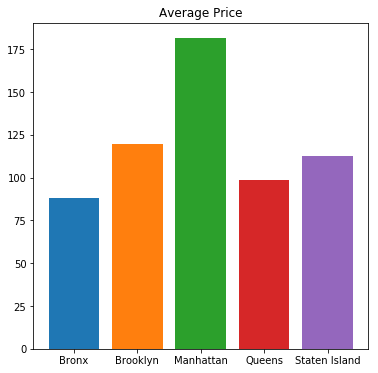

In [23]:
# Price
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

price_group = ls[["neighbourhood_group","price"]].groupby(["neighbourhood_group"]).price.mean()
plt.figure(figsize = (6,6))
plt.bar(range(len(price_group.values)),price_group.values, color=colors)
plt.xticks(range(len(price_group.values)),list(price_group.index))
plt.title("Average Price");

It seems like Airbnb's in Manhattan are the most expensive overall in comparison to the other neighborhood groups. Staten Island and Brooklyn are the next most expensive with Brooklyn seeming to be just slightly more expensive. Then Queens and finally the Bronx is the least expensive on average, however, it is pretty close to the other three group overall. 

Median gross rent from high to low from 2013-2017: Manhattan (\\$1,615), Queens (\\$1,456), Brookyln (\\$1,314), Staten Island (\\$1,229), and then Bronx (\\$1,133)

Median household income (from 2013-2017) from high to low: Manhattan (\\$79,781), Staten Island (\\$76,244), Queens (\\$62,008), Brooklyn (\\$52,781), Bronx (\\$36,593)

Top prices overall:

In [184]:
a=ls[['price','neighbourhood','neighbourhood_group']].sort_values(by=['price'],ascending=False)[:10]
a

,price,neighbourhood,neighbourhood_group
id,,,
2953058,8000,Clinton Hill,Brooklyn
2952861,4500,Clinton Hill,Brooklyn
14730708,3000,Upper West Side,Manhattan
18071399,3000,Chelsea,Manhattan
13882394,2800,Greenwich Village,Manhattan
4262120,2695,Upper West Side,Manhattan
893413,2500,East Village,Manhattan
4586448,2500,East Village,Manhattan
2659183,2500,Upper East Side,Manhattan


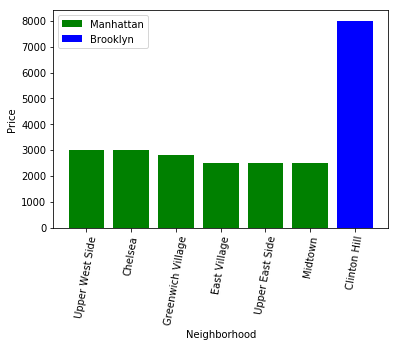

In [231]:
a1=a[a['neighbourhood_group']=='Manhattan']
a2=a[a['neighbourhood_group']=='Brooklyn']
plt.bar(a1.neighbourhood,a1['price'],color='green',label='Manhattan')
plt.bar(a2.neighbourhood,a2['price'],color='blue',label='Brooklyn')
plt.legend()
plt.xticks(rotation=80)
plt.xlabel('Neighborhood')
plt.ylabel('Price');

Top prices by borough:

In [247]:
a=ls[['price','neighbourhood','neighbourhood_group']]
a=a.sort_values(['neighbourhood_group','price'],ascending=False).groupby('neighbourhood_group').head(4)
a

,price,neighbourhood,neighbourhood_group
id,,,
2176866,1500,Westerleigh,Staten Island
20828667,800,Tottenville,Staten Island
1798271,700,Woodrow,Staten Island
738588,625,Arrochar,Staten Island
20647533,1800,Flushing,Queens
12156541,1100,Briarwood,Queens
18175061,1000,Briarwood,Queens
19313965,1000,Jamaica Estates,Queens
18071399,3000,Chelsea,Manhattan


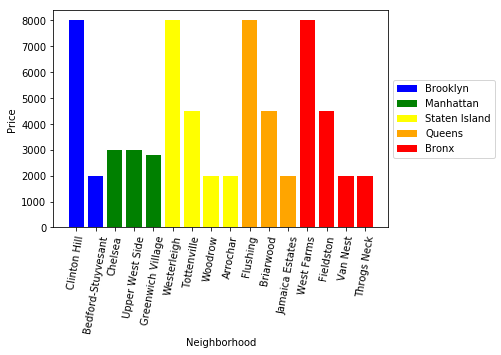

In [246]:
a1=a[a['neighbourhood_group']=='Manhattan']
a2=a[a['neighbourhood_group']=='Brooklyn']
a3=a[a['neighbourhood_group']=='Staten Island']
a4=a[a['neighbourhood_group']=='Queens']
a5=a[a['neighbourhood_group']=='Bronx']

plt.bar(a2.neighbourhood,a2['price'],color='blue',label='Brooklyn')
plt.bar(a1.neighbourhood,a1['price'],color='green',label='Manhattan')
plt.bar(a3.neighbourhood,a2['price'],color='yellow',label='Staten Island')
plt.bar(a4.neighbourhood,a2['price'],color='orange',label='Queens')
plt.bar(a5.neighbourhood,a2['price'],color='red',label='Bronx')


plt.xticks(rotation=80)
plt.xlabel('Neighborhood')
plt.ylabel('Price')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5));

Lowest prices overall:

In [306]:
a=ls[['price','neighbourhood','neighbourhood_group']].sort_values(by=['price'])[:10]
a

,price,neighbourhood,neighbourhood_group
id,,,
18737220,51,Kensington,Brooklyn
17560543,51,Harlem,Manhattan
13312655,51,Williamsburg,Brooklyn
6645516,51,Washington Heights,Manhattan
8992714,51,Bedford-Stuyvesant,Brooklyn
5051020,51,Bushwick,Brooklyn
13451943,51,Williamsburg,Brooklyn
1148978,51,Washington Heights,Manhattan
4261029,51,Harlem,Manhattan


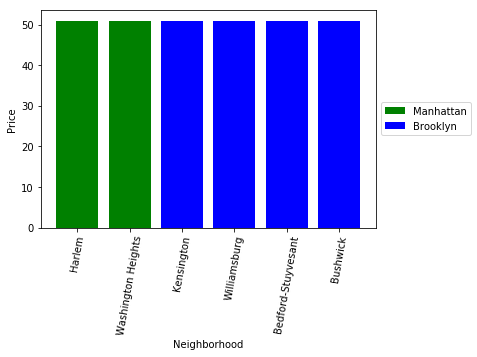

In [307]:
a1=a[a['neighbourhood_group']=='Manhattan']
a2=a[a['neighbourhood_group']=='Brooklyn']
plt.bar(a1.neighbourhood,a1['price'],color='green',label='Manhattan')
plt.bar(a2.neighbourhood,a2['price'],color='blue',label='Brooklyn')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5));
plt.xticks(rotation=80)
plt.xlabel('Neighborhood')
plt.ylabel('Price');

Lowest prices by borough:

In [256]:
a=ls[['price','neighbourhood','neighbourhood_group']]
a=a.sort_values(['neighbourhood_group','price']).groupby('neighbourhood_group').head(3)
a

,price,neighbourhood,neighbourhood_group
id,,,
18898125,51,Fordham,Bronx
1278784,52,Mott Haven,Bronx
4937093,52,Clason Point,Bronx
14670685,51,Bedford-Stuyvesant,Brooklyn
18926057,51,Bedford-Stuyvesant,Brooklyn
20425419,51,Bedford-Stuyvesant,Brooklyn
857696,51,East Harlem,Manhattan
15531089,51,East Village,Manhattan
18848869,51,Harlem,Manhattan


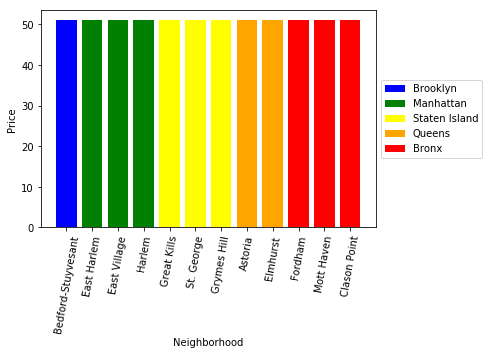

In [257]:
a1=a[a['neighbourhood_group']=='Manhattan']
a2=a[a['neighbourhood_group']=='Brooklyn']
a3=a[a['neighbourhood_group']=='Staten Island']
a4=a[a['neighbourhood_group']=='Queens']
a5=a[a['neighbourhood_group']=='Bronx']

plt.bar(a2.neighbourhood,a2['price'],color='blue',label='Brooklyn')
plt.bar(a1.neighbourhood,a1['price'],color='green',label='Manhattan')
plt.bar(a3.neighbourhood,a2['price'],color='yellow',label='Staten Island')
plt.bar(a4.neighbourhood,a2['price'],color='orange',label='Queens')
plt.bar(a5.neighbourhood,a2['price'],color='red',label='Bronx')


plt.xticks(rotation=80)
plt.xlabel('Neighborhood')
plt.ylabel('Price')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5));

In [281]:
a=ls[['price','neighbourhood','neighbourhood_group']]
a=a.groupby(['neighbourhood','neighbourhood_group']).median()
a.sort_values(['neighbourhood_group','price']).groupby('neighbourhood_group').head(3)

,,price
neighbourhood,neighbourhood_group,
Melrose,Bronx,60.0
Westchester Square,Bronx,60.0
Mount Eden,Bronx,63.5
Borough Park,Brooklyn,70.0
Cypress Hills,Brooklyn,75.0
Midwood,Brooklyn,75.0
Inwood,Manhattan,80.0
Washington Heights,Manhattan,81.0
Roosevelt Island,Manhattan,82.5


TypeError: only size-1 arrays can be converted to Python scalars

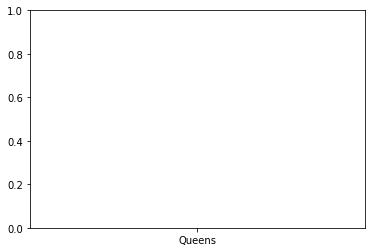

In [308]:
a=ls[['price','neighbourhood','neighbourhood_group']]
x=a.groupby(['neighbourhood','neighbourhood_group']).mean()
plt.bar(a.neighbourhood_group,a.groupby(['neighbourhood','neighbourhood_group']).mean())

In [293]:
a.iloc[:]

,,price
neighbourhood,neighbourhood_group,
Allerton,Bronx,90.0
Arrochar,Staten Island,114.0
Arverne,Queens,129.0
Astoria,Queens,95.0
Bath Beach,Brooklyn,89.0
Battery Park City,Manhattan,225.0
Bay Ridge,Brooklyn,85.0
Bay Terrace,Queens,90.0
"Bay Terrace, Staten Island",Staten Island,112.5


In [282]:
a1=a[a['neighbourhood_group']=='Manhattan']
a2=a[a['neighbourhood_group']=='Brooklyn']
a3=a[a['neighbourhood_group']=='Staten Island']
a4=a[a['neighbourhood_group']=='Queens']
a5=a[a['neighbourhood_group']=='Bronx']

plt.bar(a2.neighbourhood,a2['price'],color='blue',label='Brooklyn')
plt.bar(a1.neighbourhood,a1['price'],color='green',label='Manhattan')
plt.bar(a3.neighbourhood,a2['price'],color='yellow',label='Staten Island')
plt.bar(a4.neighbourhood,a2['price'],color='orange',label='Queens')
plt.bar(a5.neighbourhood,a2['price'],color='red',label='Bronx')


plt.xticks(rotation=80)
plt.xlabel('Neighborhood')
plt.ylabel('Price')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5));

KeyError: 'neighbourhood_group'

In [280]:
x=ls[['price','neighbourhood','neighbourhood_group']]
x=x.groupby(['neighbourhood','neighbourhood_group']).mean()
x.sort_values(['neighbourhood_group','price']).groupby('neighbourhood_group').head(3)

,,price
neighbourhood,neighbourhood_group,
Westchester Square,Bronx,60.000000
Mount Eden,Bronx,63.500000
Morris Park,Bronx,65.000000
Cypress Hills,Brooklyn,87.472727
Midwood,Brooklyn,96.816901
Fort Hamilton,Brooklyn,97.540541
Marble Hill,Manhattan,97.600000
Inwood,Manhattan,98.827411
Washington Heights,Manhattan,106.308495


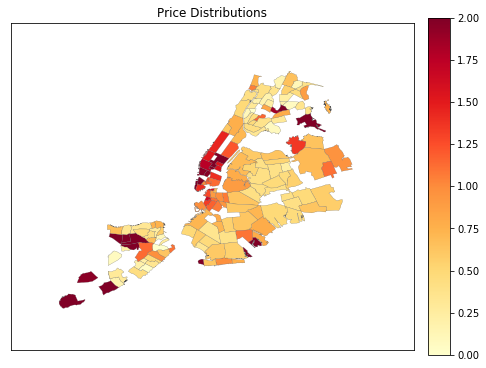

In [180]:
# Price Geometry Distribution 

prices = listings_detail[["neighbourhood","price","reviews_per_month"]].groupby(["neighbourhood"]).price.mean()
priceMap = dict(prices)

max_ = max(priceMap.values())
min_ = min(priceMap.values())
def norm_transform(price):
    return (price-min_)/( 250 - min_)#Hard Coding Truncature Here at 250 USD here to see a more meaningful result

###############SET UP LIMITS#########################
mp = nbgeo.geometry.loc[101]
cm = plt.get_cmap('YlOrRd')


fig = plt.figure(figsize=(6,6))
ax = fig.add_subplot(111)
minx, miny, maxx, maxy = mp.bounds
w, h = maxx - minx, maxy - miny
ax.set_xlim(minx - 20 * w, maxx + 5 * w)
ax.set_ylim(miny - 10 * h, maxy + 8 * h)
ax.set_aspect(1)

###############ADD NEIGHBOURS#########################
for i in range(len(nbgeo.geometry)):
    patches = []
    mp = nbgeo.geometry.loc[i]
    nb = nbgeo.neighbourhood.loc[i]
    try:
        price = priceMap[nb]
    except:
        continue
    for idx, p in enumerate(mp):
        colour = cm(norm_transform(price))
        patches.append(PolygonPatch(p, fc=colour, ec='#555555', lw=0.2, alpha=1., zorder=1))
        ax.add_collection(PatchCollection(patches, match_original=True))

###############DRAW##################################
ax.set_xticks([])
ax.set_yticks([])
plt.title("Price Distributions")
plt.tight_layout()
##NOTE that the price values are normalized 
ax  = fig.add_axes([1,0.11,0.05,0.78])
norm = mpl.colors.Normalize(vmin=0,vmax=2)
cb1  = mpl.colorbar.ColorbarBase(ax,cmap=cm,norm=norm,orientation='vertical')

plt.show()

#### Popularity
We are defining popularity in terms of availibilty, meaning more popular airbnb's have less availability and less popular ones have more

In [ ]:
#Merge listing details and listing summary to get neighborhood group in listing details
ldmergels=pd.merge(ld,ls,left_index=True, right_index=True, how='left')

In [106]:
ldmergels['availability_365'].groupby(ldmergels['neighbourhood_group']).sum()
#Number of availibilities by neighborhood - higher means less popular

neighbourhood_group
Bronx            162886 
Brooklyn         2248498
Manhattan        2355798
Queens           748243 
Staten Island    65367  
Name: availability_365, dtype: int64

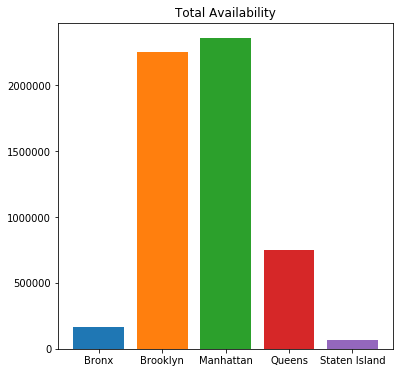

In [107]:
# Total Availability
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

avail_group = ldmergels.availability_365.groupby(ldmergels["neighbourhood_group"]).sum()
plt.figure(figsize = (6,6))
plt.bar(range(len(avail_group.values)),avail_group.values, color=colors)
plt.xticks(range(len(avail_group.values)),list(avail_group.index))
plt.title("Total Availability");

This can be misleading since there are way more Airbnbs in general in Manhattan and Brooklyn, so there will therefore be more available rooms. Maybe we can make this relative to the amount of Airbnb's there are so that we get an average available days per Airbnb by neighborhood.

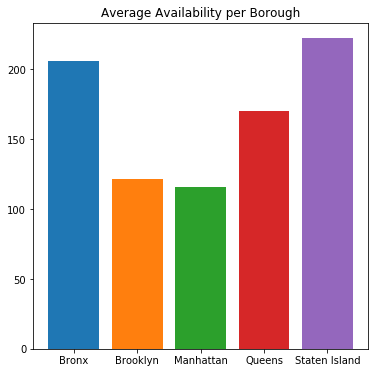

In [99]:
# Average Availability
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

avail_group = (ldmergels["availability_365"].groupby(ldmergels["neighbourhood_group"]).sum())/(ldmergels['host_id'].groupby(ldmergels['neighbourhood_group']).count())
plt.figure(figsize = (6,6))
plt.bar(range(len(avail_group.values)),avail_group.values, color=colors)
plt.xticks(range(len(avail_group.values)),list(avail_group.index))
plt.title("Average Availability per Borough");

This is the availability relative to the amount of Airbnb's in the area. This plot paints a much different picture which is much more accurate. For the amount of Airbnb's there are in Staten Island, they are on average more available than any other neighbourhood group (least popular). The Bronx also has a lot of availability on average compared to the others - so we could say the Bronx is the second to least popular. Queens seems to be the more popular than Staten Island and the Bronx since it has less availability than those. Brooklyn, and Manhattan have VERY similar averages which is interesting - so they have about the same popularity and are the msot popular. 

I used the values below to check that the average was calculated properly which it was. It is the amount of available days per neighbourhood group divided by the total number of Airbnbs in each neighborhood group - to get the average amount of available days per Airbnb within each neighborhood group (borough)

In [109]:
#Check the averages:
avail_group/(ldmergels['host_id'].groupby(ldmergels['neighbourhood_group']).count())

neighbourhood_group
Bronx            205.924147
Brooklyn         121.737845
Manhattan        115.650368
Queens           170.364982
Staten Island    222.336735
dtype: float64

In [108]:
avail_group #Used this to check that this is the amount of available days for each neighborhood group 

neighbourhood_group
Bronx            162886 
Brooklyn         2248498
Manhattan        2355798
Queens           748243 
Staten Island    65367  
Name: availability_365, dtype: int64

##### Are there times when no Airbnbs are available or extremely limited and on what dates does this occur?

In [31]:
cdmergels.available.groupby(cdmergels.date).sum().sort_values()[:10]

date
2017-10-02    190
2017-10-07    309
2017-10-06    331
2017-10-03    397
2017-10-05    401
2017-10-04    435
2017-10-08    467
2017-10-13    559
2017-10-14    569
2017-10-09    593
Name: available, dtype: int64

There are no times when there are no Airbnbs available but the dates when the fewest are available are October 10, October 7, October 6, October 3, and October 5, 2017 

In [32]:
cdmergels.available.groupby(cdmergels.date).sum().sort_values(ascending=False)[:10]

date
2018-03-20    1849
2018-03-22    1846
2018-03-21    1845
2018-03-19    1843
2018-03-23    1843
2018-03-17    1839
2018-03-18    1838
2018-03-25    1834
2018-03-24    1832
2018-03-15    1831
Name: available, dtype: int64

The dates with the greatest number of Airbnb's available are around March 20th, 2018

##### On what dates do the most crime occur?

In [124]:
crime.OFNS_DESC.groupby(crime['ARREST_DATE']).count().sort_values()[:5]

ARREST_DATE
2014-09-06    54 
2014-12-25    136
2017-12-25    161
2015-12-25    185
2014-12-31    212
Name: OFNS_DESC, dtype: int64

In [125]:
crime.OFNS_DESC.groupby(crime['ARREST_DATE']).count().sort_values(ascending=False)[:5]

ARREST_DATE
2014-10-08    1420
2014-10-09    1410
2014-10-14    1378
2015-02-12    1374
2014-10-17    1369
Name: OFNS_DESC, dtype: int64

The most crimes occurred on October 8th,9th and 14th, 2014, February 12th, 2015, and October 17, 2014. The least amount of crimes occurred on September 6, 2014, December 25, 2014 (Christmas!!) also in 2015 and 2017!! Also on December 31, 2014 (NYE).
Very interesting and also sad that such a large amount of crimes are committed on Christmas for several years

<b> Want to try to plot this with date as x axis or maybe we could do a time series by borough

#### Reviews

In [21]:
#Need to see whole record to read the full review
pd.set_option('display.max_colwidth', -1)

In [133]:
len(reviews.index)

801784

There are 801,784 reviews total. First we will try to extract as many positive comments as possible. However, we may not account for all of them since there are so many different positive words that can be included in the comments. Also, some comments have some positive feedback and some negative feeback as well. In these cases, the feedback is overall positive but a few issues or problems are pointed out. Since many that I looked over seem to be mostly postive than negative, we first search for negative comments from ones that are not found as positive. However, then the number of negative comments was extremely small compared to the number of positive ones. Instead, we ended up just defined positive comments as those that included at least one of the positive words in the regular expression below and then negative comments were ones that contained at least one of the negative words. So some comments were counted as both positive and negative if they had both positive and negative words included in the comment.

In [74]:
reviews['goodcomments'] = reviews['comments'].str.contains('good|great|wonderful|love|nice|loved|prompt|awesome|easy|lovely|accommodating|neat|perfect|would_recommend|terrific|fantastic|responsive|kind|pleasure|pleasant|ideal|convenient|beautiful|clean|enjoy|easily_accesible|friendly|welcoming|quiet|helpful|comf|best|reasonable|priva|communicative|appreciate|modern|value|thank|decent|cool|worth|amazing', case=False)

In [75]:
len(reviews[reviews['goodcomments']==True])

696965

683,888 reviews are considered "positive" by our definition, meaning it contains at least one of the words above. This is not a perfect approach and it is not guarenteed that all of these comments are positive but that is what we are assuming. Next, we try to find reviews that are considered negative, meaning they contain at least one of the negative words in the regular expression below.It's also important to note  that there are many cases where the review is in a different language or a default review of "The host canceled this reservation. This is an automated posting." We don't want those to be considered negative since they may not be. In these cases, we don't want these comments to be considered positive or negative. I'm not sure how we could delete those comments. 

In [77]:
reviews['badcomments']=reviews['comments'].str.contains('messy|dirty|expensive|loud|nois|bugs|warning|bad|awful|refund|disappoint|terrible|shame|unhappy|unhelpful|annoy|disgusting|"not recommend"',case=False)

In [78]:
len(reviews[reviews['badcomments']==True])

53358

In [50]:
len(reviews[reviews['goodcomments']==True])+len(reviews[reviews['badcomments']==True])

750323

So we've only accounted for _____750323___ (may change) out of the 801784 reviews total. We may still need to try to find out the number of reviews that are automated or in a different language to see how many we have missed. 

In [79]:
reviewsmergels=pd.merge(reviews, ls, left_index=True, right_index=True, how='left')

In [80]:
reviewsmergels['goodcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()

neighbourhood_group
Bronx            11747 
Brooklyn         282276
Manhattan        321962
Queens           75699 
Staten Island    5281  
Name: goodcomments, dtype: int64

In [29]:
reviewsmergels['badcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()

neighbourhood_group
Bronx            753  
Brooklyn         19243
Manhattan        28237
Queens           4768 
Staten Island    357  
Name: badcomments, dtype: int64

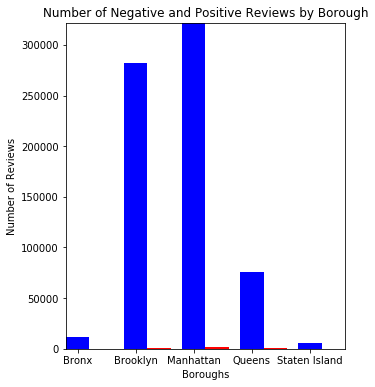

In [216]:
fig, ax = plt.subplots(figsize=(11,6))

x=range(len(y))
x1=[0.4,1.4,2.4,3.4,4.4]

y=reviewsmergels['goodcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()
z=reviewsmergels['badcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()

ax=plt.subplot(121)
ax.bar(x,y,color='b',width=0.4,align='center')
ax.bar(x1,z,color='r',width=0.4,align='center')
plt.xlabel('Boroughs')
plt.xticks((0,1,2,3,4),['Bronx','Brooklyn','Manhattan','Queens','Staten Island'])
plt.ylabel('Number of Reviews')
plt.title('Number of Negative and Positive Reviews by Borough')
ax.autoscale(tight=True)
##Need to add legend if we want to use this graph

plt.show()

Since there is such a small amount of negative reviews compared to positive, this is a terrible graph to compare the two. However, it does get the point across that there appears to be hardly any negative reviews compared to positive ones. In the next graph we plot the two separately, so we can see the distributions of the negative reviews as well as the positive reviews for each borough. It is important to note that the range of the y-axis scales are very different.

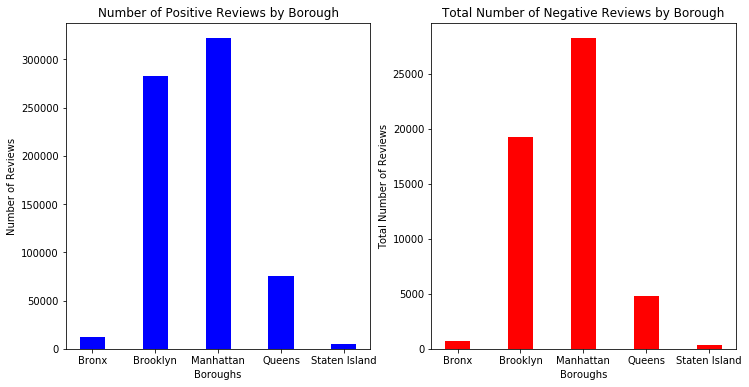

In [143]:
fig, ax = plt.subplots(figsize=(12,6))
x=range(len(y))
x1=[0.4,1.4,2.4,3.4,4.4]
y=reviewsmergels['goodcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()
z=reviewsmergels['badcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()
ax=plt.subplot(121)
ax.bar(x,y,color='b',width=0.4,align='center')
plt.xlabel('Boroughs')
plt.xticks((0,1,2,3,4),['Bronx','Brooklyn','Manhattan','Queens','Staten Island'])
plt.ylabel('Number of Reviews')
plt.title('Number of Positive Reviews by Borough')

ax=plt.subplot(122)
ax.bar(x,z,color='r',width=0.4,align='center')
plt.xlabel('Boroughs')
plt.xticks((0,1,2,3,4),['Bronx','Brooklyn','Manhattan','Queens','Staten Island'])
plt.ylabel('Total Number of Reviews')
plt.title('Total Number of Negative Reviews by Borough')


plt.show()

We should probably find the average number of positive/negative reviews per borough like we did before with the availability. Since obviously Manhattan and Brooklyn are likely to have the most reviews since they have the most Airbnbs. 

In [97]:
reviewsmergels['goodcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()/(ls['host_id'].groupby(ls['neighbourhood_group']).count())

neighbourhood_group
Bronx            14.850822
Brooklyn         15.282945
Manhattan        15.805695
Queens           17.235656
Staten Island    17.962585
dtype: float64

In [38]:
reviewsmergels['badcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()/(ls['host_id'].groupby(ls['neighbourhood_group']).count())

neighbourhood_group
Bronx            0.951960
Brooklyn         1.041852
Manhattan        1.386205
Queens           1.085610
Staten Island    1.214286
dtype: float64

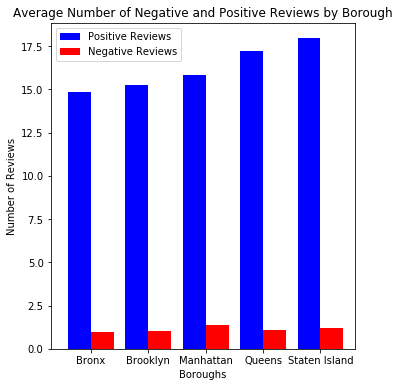

In [81]:
fig, ax = plt.subplots(figsize=(12,6))

x=[.2,1.2,2.2,3.2,4.2]
x1=[0.6,1.6,2.6,3.6,4.6]
y=reviewsmergels['goodcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()/(ls['host_id'].groupby(ls['neighbourhood_group']).count())
z=reviewsmergels['badcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()/(ls['host_id'].groupby(ls['neighbourhood_group']).count())

ax=plt.subplot(121)
ax.bar(x,y,color='b',width=0.4,align='center',label='Positive Reviews')
ax.bar(x1,z,color='r',width=0.4,align='center',label='Negative Reviews')
plt.xlabel('Boroughs')
plt.xticks((0.4,1.4,2.4,3.4,4.4),['Bronx','Brooklyn','Manhattan','Queens','Staten Island'])
plt.ylabel('Number of Reviews')
plt.title('Average Number of Negative and Positive Reviews by Borough')
plt.xlim(-.3,5)
##Need to add legend if we want to use this graph
leg=ax.legend()
plt.show()

Or if we want to plot the two separately to get a better sense of the distribution of negative comments:

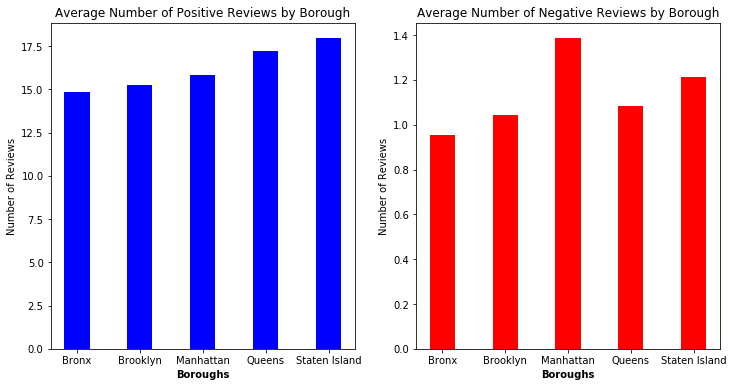

In [82]:
fig, ax = plt.subplots(figsize=(12,6))

y=reviewsmergels['goodcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()/(ls['host_id'].groupby(ls['neighbourhood_group']).count())
z=reviewsmergels['badcomments'].groupby(reviewsmergels['neighbourhood_group']).sum()/(ls['host_id'].groupby(ls['neighbourhood_group']).count())
x=range(len(y))

ax=plt.subplot(121)
ax.bar(x,y,color='b',width=0.4,align='center')
plt.xlabel('Boroughs',weight='bold')
plt.xticks((0,1,2,3,4),['Bronx','Brooklyn','Manhattan','Queens','Staten Island'])
plt.ylabel('Number of Reviews')
plt.title('Average Number of Positive Reviews by Borough')

ax=plt.subplot(122)
ax.bar(x,z,color='r',width=0.4,align='center')
plt.xlabel('Boroughs',weight='bold')
plt.xticks((0,1,2,3,4),['Bronx','Brooklyn','Manhattan','Queens','Staten Island'])
plt.ylabel('Number of Reviews')
plt.title('Average Number of Negative Reviews by Borough')


plt.show()

In [78]:
#Don't want to see whole record anymore since some have paragraph entries
pd.reset_option("^display")

<b> Issue: There may be reviews not accounted for. We need to figure out how to filter out the ones in a different language and the automated ones to try to see how many have been left out. However, even still, there are some comments that are counted for as both positive and negative so I'm not sure how we can do this. 


### Question 2: 
Do factors such as number of cancellation policy, instant bookable, house rules, amenities, access (entire apartment vs private room), room type (private vs shared), transit, or number of guests significantly impact whether or not an Airbnb is booked?



#### Cancellation Policy

In [8]:
cdmergeldls.corr()

,price_x,host_id,latitude,longitude,price_y,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price,accommodates,beds,bathrooms,bedrooms
price_x,1.000000,-0.047947,0.021366,-0.184137,0.977260,-0.023561,-0.073716,-0.064556,0.067763,0.050314,0.977260,0.427839,0.373016,0.401696,0.412429
host_id,-0.047947,1.000000,0.016587,0.015717,-0.018396,-0.035071,-0.086915,0.019981,-0.108917,-0.079646,-0.018396,-0.054819,-0.048062,-0.021097,-0.033419
latitude,0.021366,0.016587,1.000000,0.190047,0.025315,0.008291,0.038317,0.024808,-0.005915,0.011958,0.025315,-0.090468,-0.090678,-0.079148,-0.113937
longitude,-0.184137,0.015717,0.190047,1.000000,-0.197531,-0.011778,0.003863,0.012526,0.119211,0.098446,-0.197531,0.000513,0.017625,-0.049917,-0.003620
price_y,0.977260,-0.018396,0.025315,-0.197531,1.000000,-0.017162,-0.080374,-0.066591,0.036160,0.015957,1.000000,0.420488,0.384980,0.400832,0.399427
minimum_nights,-0.023561,-0.035071,0.008291,-0.011778,-0.017162,1.000000,-0.110471,-0.108307,-0.017046,-0.020619,-0.017162,-0.022869,-0.016431,-0.018531,0.004532
number_of_reviews,-0.073716,-0.086915,0.038317,0.003863,-0.080374,-0.110471,1.000000,0.843931,-0.019877,0.209516,-0.080374,0.078648,0.046271,-0.047655,-0.029500
reviews_per_month,-0.064556,0.019981,0.024808,0.012526,-0.066591,-0.108307,0.843931,1.000000,-0.034938,0.155976,-0.066591,0.052057,0.036546,-0.038933,-0.021378
calculated_host_listings_count,0.067763,-0.108917,-0.005915,0.119211,0.036160,-0.017046,-0.019877,-0.034938,1.000000,0.208076,0.036160,0.073152,0.040518,0.019873,-0.038243
availability_365,0.050314,-0.079646,0.011958,0.098446,0.015957,-0.020619,0.209516,0.155976,0.208076,1.000000,0.015957,0.069202,0.076760,0.023488,0.027631


<b> Issue: There are some that have 0 availability for over a year and I don't think this is because they are booked I think they are no longer or at least temporarily not offering their Airbnb. 

In [145]:
ldmergels.cancellation_policy.groupby([ldmergels['cancellation_policy'],ldmergels['neighbourhood_group']]).size()

cancellation_policy  neighbourhood_group
flexible             Bronx                  288 
                     Brooklyn               6026
                     Manhattan              5974
                     Queens                 1455
                     Staten Island          87  
long_term            Brooklyn               1   
moderate             Bronx                  207 
                     Brooklyn               4789
                     Manhattan              4477
                     Queens                 1102
                     Staten Island          80  
strict               Bronx                  296 
                     Brooklyn               7652
                     Manhattan              9906
                     Queens                 1834
                     Staten Island          127 
super_strict_30      Brooklyn               2   
                     Manhattan              10  
                     Queens                 1   
super_strict_60      Manhatt

Cancellation policy by neighbourhood group:

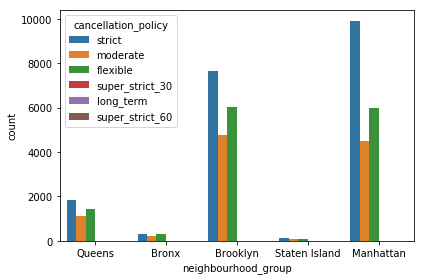

In [161]:
ax=sns.countplot(ldmergels['neighbourhood_group'], hue=ldmergels["cancellation_policy"])
ax.set_xticklabels(ax.get_xticklabels())
plt.tight_layout()
plt.show()

Cancellation policy and <b>availability</b> by neighbourhood group:

<b> Need to fix plot below

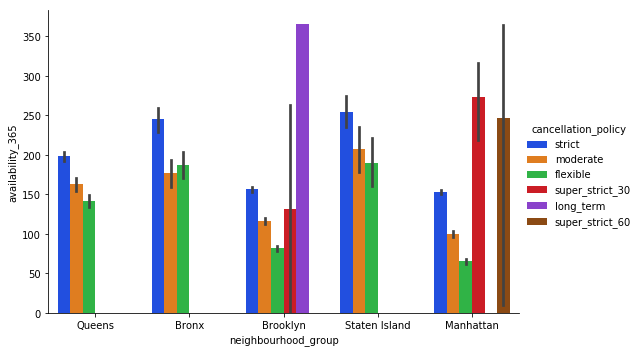

In [176]:
ax = sns.catplot(x='neighbourhood_group',y="availability_365", hue="cancellation_policy",palette="bright", data=ldmergels, kind='bar',aspect=1.5)
plt.show()

Cancellation policy and <b>price</b> by neighbourhood group:

<b>Also need to fix this plot, not sure if we will even use it

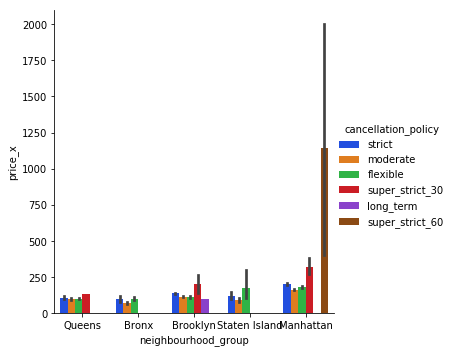

In [16]:
ax = sns.catplot(x='neighbourhood_group',y="price_x", hue="cancellation_policy",palette="bright", data=ldmergels, kind='bar')

#### House Rules

In [20]:
pd.set_option('display.max_colwidth', -1)
ld.house_rules

id
18461891    NaN                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                      

In [177]:
h=ld['house_rules'].str.contains('no smoking|no pets|don"t smoke in|no extra guests|no food in room|no strange guests|no additional guests', case=False)

In [170]:
import plotly.graph_objects as go

In [171]:
data_neighgroup_roomtype=ls.groupby(["room_type","neighbourhood_group"])["neighbourhood_group"].count()
## BARPLOT ##
x=data_neighgroup_roomtype.index.levels[1]
room_type=data_neighgroup_roomtype.index.levels[0]
fig_bar = go.Figure(go.Bar(x=x, y=data_neighgroup_roomtype["Entire home/apt"], name=room_type[0]),layout=go.Layout(title=go.layout.Title(text="Room type per Neighbourhood")))
fig_bar.add_trace(go.Bar(x=x, y=data_neighgroup_roomtype["Private room"], name=room_type[1]))
fig_bar.add_trace(go.Bar(x=x, y=data_neighgroup_roomtype["Shared room"], name=room_type[2]))
fig_bar.update_layout(title="Number of apartments",barmode='group', xaxis={'categoryorder':'category ascending'})

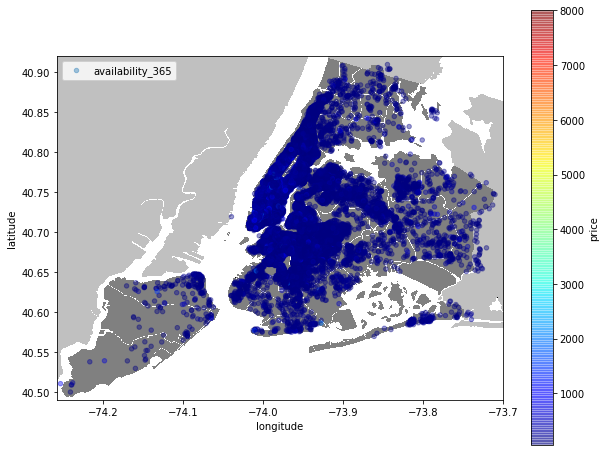

In [173]:
import urllib
#initializing the figure size
plt.figure(figsize=(10,8))
#loading the png NYC image found on Google and saving to my local folder along with the project
i=urllib.request.urlopen('https://upload.wikimedia.org/wikipedia/commons/e/ec/Neighbourhoods_New_York_City_Map.PNG')
nyc_img=plt.imread(i)
#scaling the image based on the latitude and longitude max and mins for proper output
plt.imshow(nyc_img,zorder=0,extent=[-74.258, -73.7, 40.49,40.92])
ax=plt.gca()
#using scatterplot again
ls.plot(kind='scatter', x='longitude', y='latitude', label='availability_365', c='price', ax=ax, 
           cmap=plt.get_cmap('jet'), colorbar=True, alpha=0.4, zorder=5)
plt.legend()
plt.show()

### Question 3: 
How important are reviews and how much do they affect whether or not an Airbnb gets booked?

### Question 5:
What hosts are busiest? Why?

### Visualize Data on Map
- What areas are most popular? why?

#### Number of Airbnbs by Neighbourhood

In [89]:
#Use host id since there are no missing - meaning we get every record when counting
ls['host_id'].groupby(ls['neighbourhood_group']).count()

neighbourhood_group
Bronx              791
Brooklyn         18470
Manhattan        20370
Queens            4392
Staten Island      294
Name: host_id, dtype: int64

Text(0.5, 0, 'Borough')

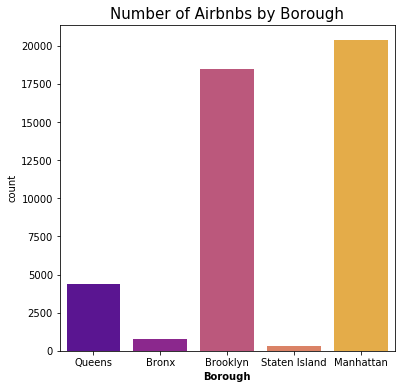

In [182]:
#https://www.kaggle.com/darkrubiks/nyc-airbnb-exploratory-analysis
#Amount of Airbnbs by borough
plt.figure(figsize=(6,6))
ax = sns.countplot(ls["neighbourhood_group"], palette="plasma" ) 
plt.title('Number of Airbnbs by Borough',color = 'k',fontsize = 15)
plt.xlabel('Borough',weight='bold')

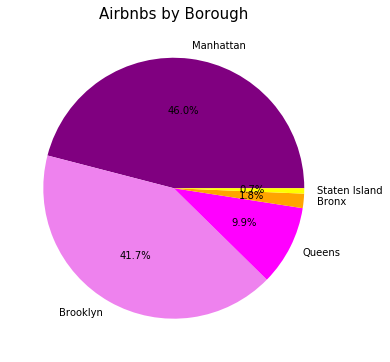

In [184]:
labels = ls.neighbourhood_group.value_counts().index
colors = ['purple','violet','fuchsia','orange','yellow']
#colors = ['lime','blue','teal','cyan','green']
explode = [0,0,0,0,0]
sizes = ls.neighbourhood_group.value_counts().values

plt.figure(0,figsize = (6,6))
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%')
plt.title('Airbnbs by Borough',color = 'k',fontsize = 15)
plt.show()

In [63]:
import folium
from random import sample 
from folium.plugins import HeatMap
# positions = [] 
# for index, row in arrest.iterrows():
positions = list(zip(ls['latitude'], ls['longitude']))
tiles = 'Stamen Terrain'
fol = folium.Map(location=[40.75,-73.98], zoom_start=10, tiles = tiles)
pos_samp = sample(positions, 22000)#22K is the max now as we join both DS togather 
HeatMap(pos_samp, radius = 8).add_to(fol) 
fol.save('map.html')

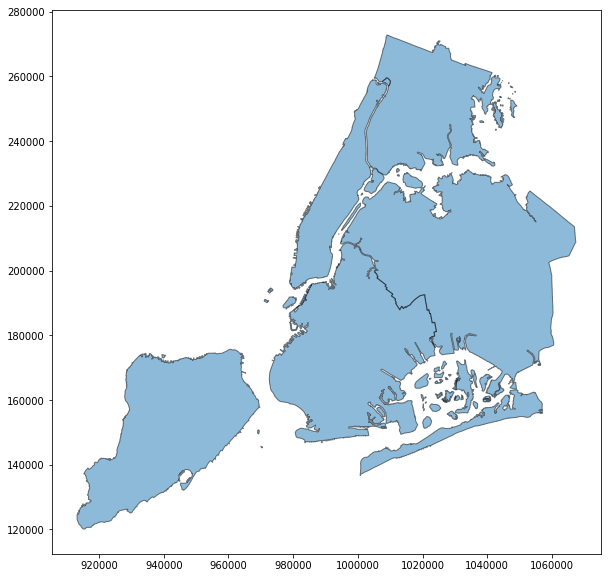

In [186]:
df = gpd.read_file(gpd.datasets.get_path('nybb'))
ax = df.plot(figsize=(10, 10), alpha=0.5, edgecolor='k')

May not need this map since we have a better one below. Still need to figure out how to plot crime ontop

https://blog.dominodatalab.com/creating-interactive-crime-maps-with-folium/

In [66]:
import folium
from random import sample 
from folium.plugins import HeatMap
# positions = [] 
# for index, row in arrest.iterrows():
positions = list(zip(crime['Latitude'], crime['Longitude']))
tiles = 'Stamen Terrain'
fol = folium.Map(location=[40.75,-73.98], zoom_start=10, tiles = tiles)
pos_samp = sample(positions, 22000)#22K is the max now as we join both DS togather 
HeatMap(pos_samp, radius = 8).add_to(fol) 
fol

In [29]:
import plotly.express as px
import math
from IPython.display import HTML, display

In [51]:
positions_edu = [] 

for index, row in listings_detail.iterrows():
    if not math.isnan(row['latitude']) :
        positions_edu.append((row['latitude'], row['longitude']))
positions_arr = list(zip(crime['Latitude'], crime['Longitude']))
fol = folium.Map(location=[40.75,-73.98], zoom_start=11, control_scale=True, parse_html=True)

pos_samp = sample(positions_arr, 22000)#22K is the max now as we join both DS togather 
HeatMap(pos_samp, radius = 7).add_to(fol) 

for pos in positions_edu:
    folium.CircleMarker(location=[pos[0],pos[1]], radius=1, color='red', fill=False,).add_to(fol)

fol

Can't get output to show